# K means 

Using K-Means clustering forimage segmentation: 

1) Bring your own data: find three images you’d like to workwith. \
2) Exp 1: Change k and try out how segmentation results vary. \
3) Exp 2: Add spatial information in clustering and segmentation. \
4) Display the results by replacing originalpixel values withpixelvalues of centroids. \
5) Write a brief report with segmentation results.  In your report, show both raw images and various output images with different k valuesand provide a summary of what you’ve learned bytrying the algorithm in different ways.

[KD nuggets tutorial](https://www.kdnuggets.com/2019/08/introduction-image-segmentation-k-means-clustering.html)

[Medium](https://medium.com/analytics-vidhya/image-segmentation-using-k-means-clustering-algorithm-python-cef588a79a63)

In [1]:
import pandas as pd
import numpy as np
import cv2
import matplotlib as mpl
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import glob

## Exp 1: Change k and try out how segmentation results vary

In [2]:
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

K = [3, 5, 7]
attempts = 10
figure_size = 20

In [3]:
image_files = glob.glob(os.getcwd() + "/*.jpeg")
image_files

['/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_1760.jpeg',
 '/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_9548.jpeg',
 '/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_2085.jpeg']

/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_1760.jpeg


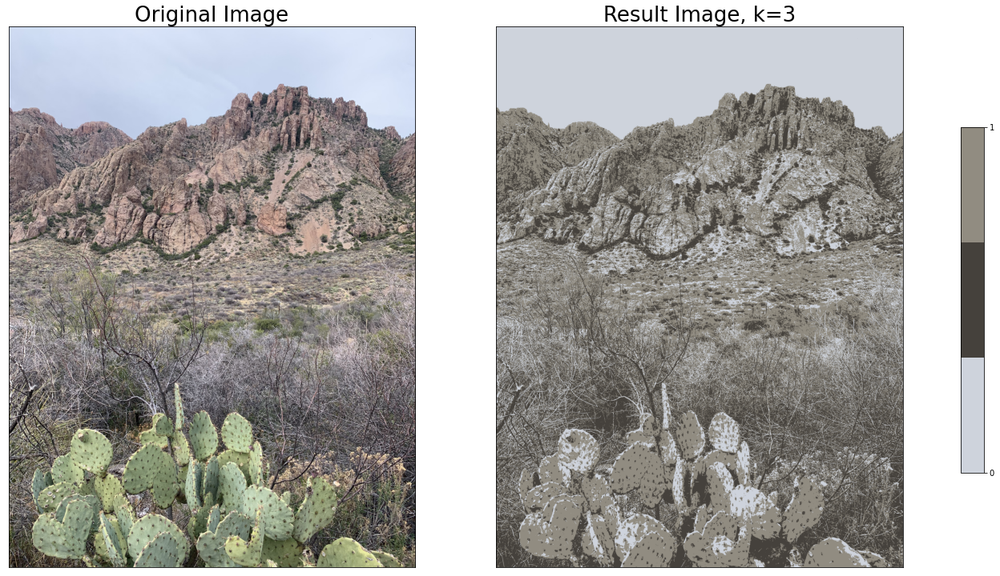

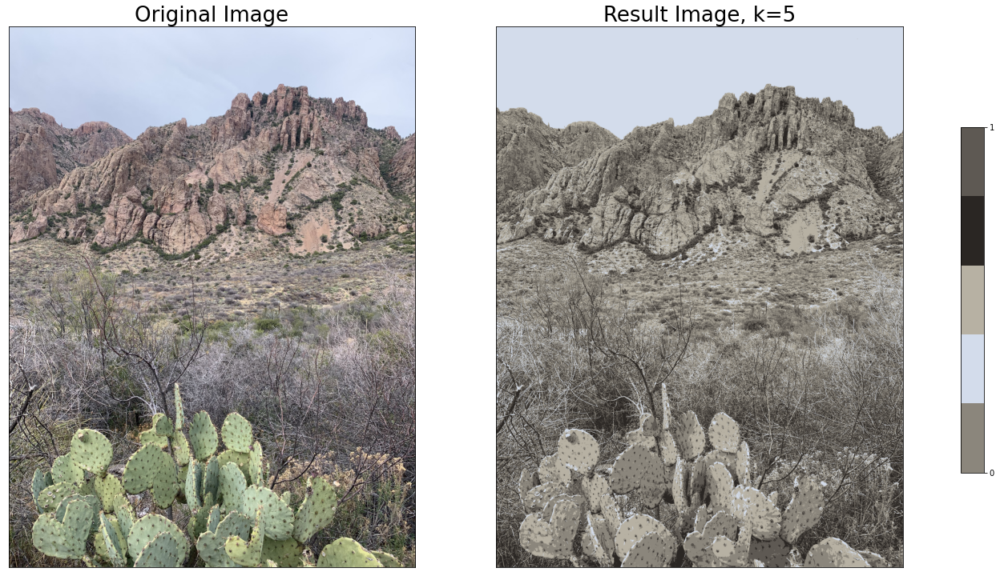

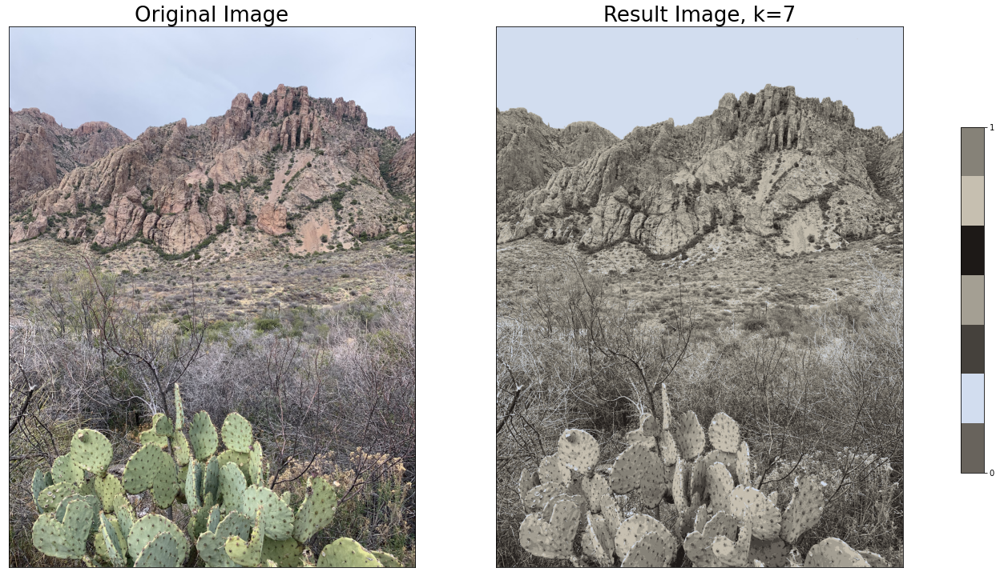

/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_9548.jpeg


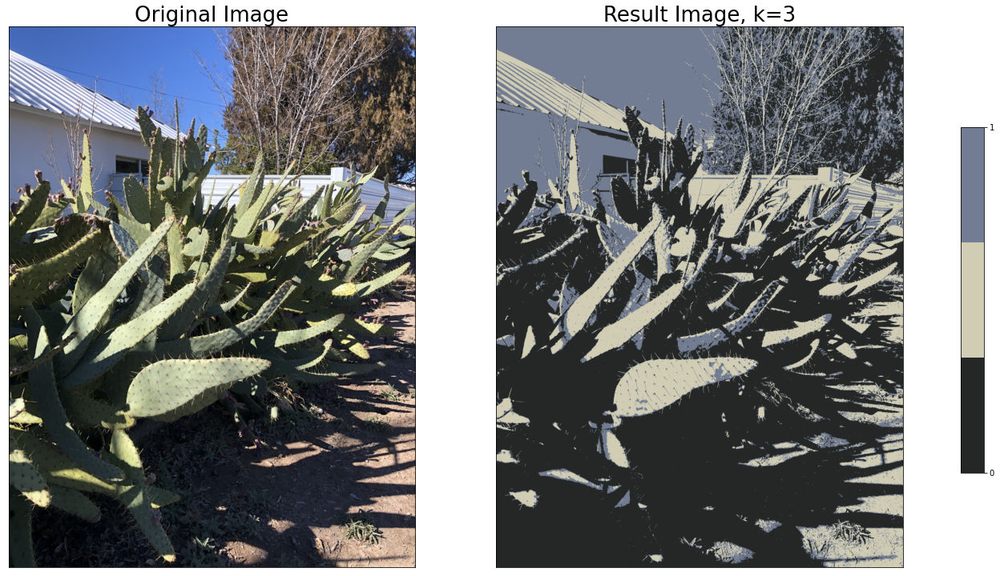

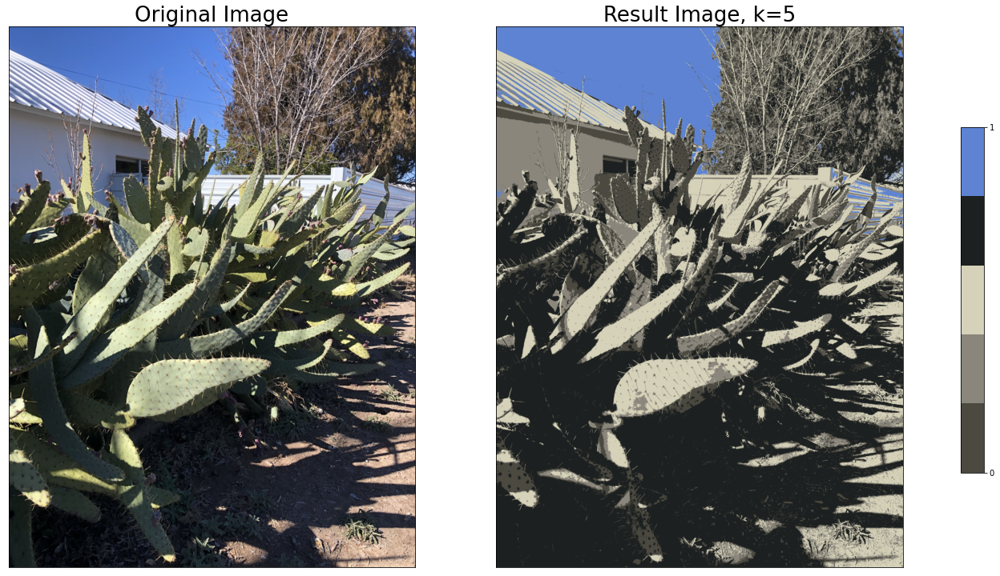

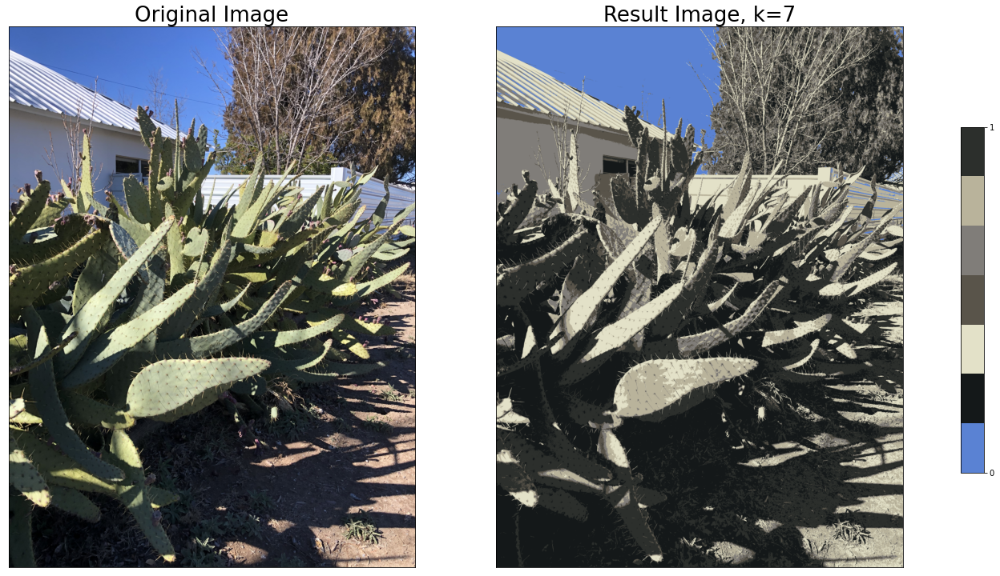

/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_2085.jpeg


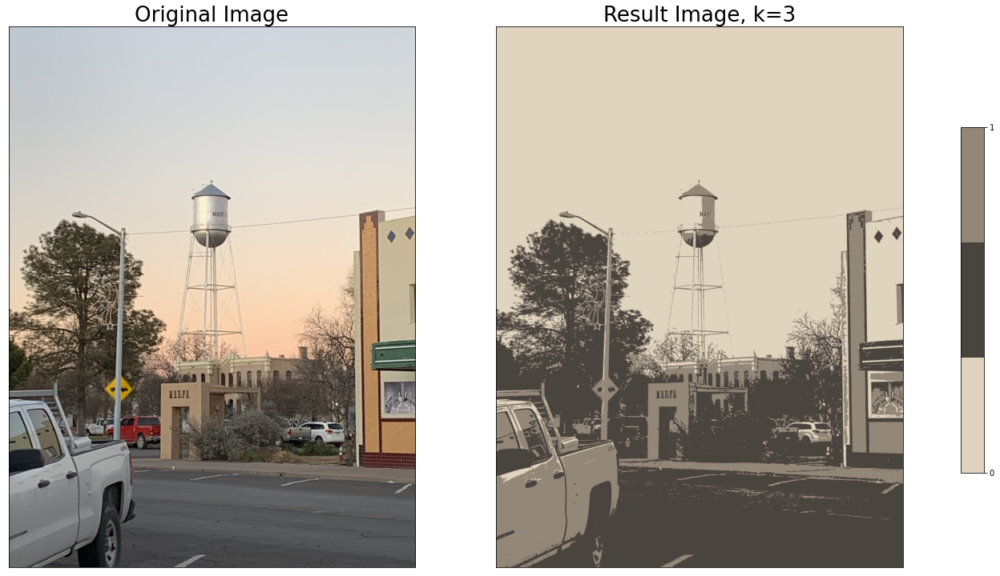

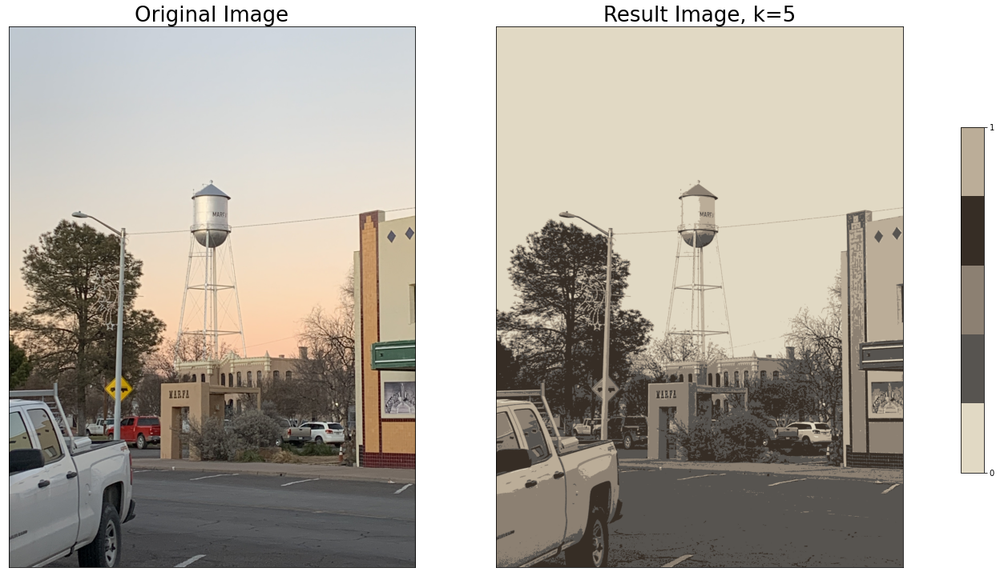

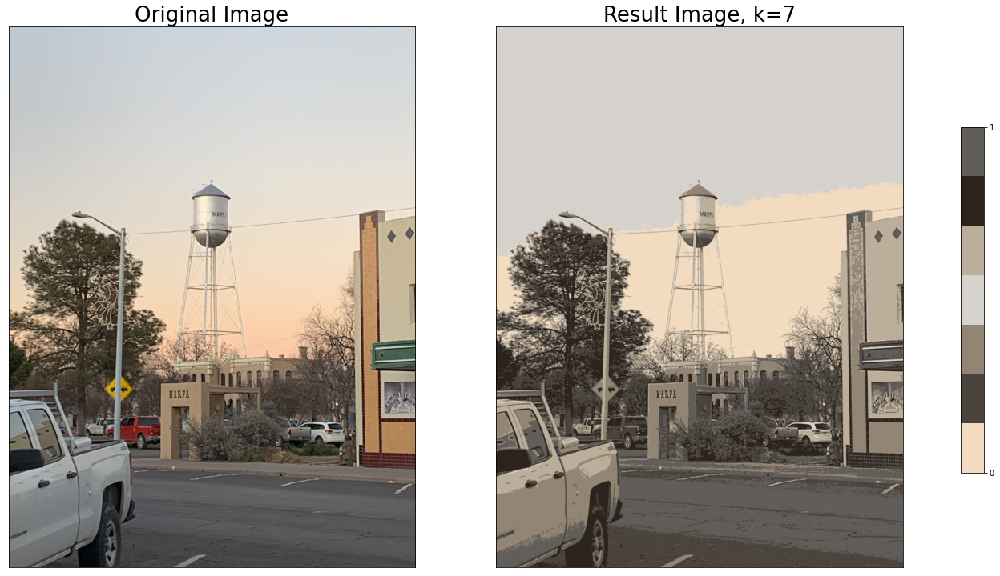

In [4]:
for image in image_files:
    
    print(image)
    
    img0 = cv2.imread(image)
    img0 = cv2.cvtColor(img0, cv2.COLOR_BGR2RGB)
    
    # convert to float32 (
    img = img0.astype(np.float32)
    
    #convert the MxNx3 image to a Kx3 image where k = MxN
    vectorized = img.reshape((-1,3))

    for k in K:

        ret,label,center=cv2.kmeans(vectorized,k,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)

        center = np.uint8(center)

        res = center[label.flatten()]
        result_image = res.reshape((img.shape))
        cv2.imwrite(image.split('/IMG')[0] + '/results/' + image.split('kmeans/')[1].split('.jpeg')[0] + '_k-%s.jpeg' % k, result_image)

        fig, axs = plt.subplots(1,2, figsize=(20, 20))
        axs[0].imshow(img0)
        axs[0].set_title('Original Image', fontsize = 26)

        axs[1].imshow(result_image)
        axs[1].set_title('Result Image, k=%s' % int(k), fontsize = 26)

        cmap = mpl.colors.ListedColormap(center/255)
        bounds = np.linspace(0, len(center), len(center), dtype=int)
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

        cb_ax = fig.add_axes([0.95, 0.35, 0.02, 0.3])
        cbar = fig.colorbar(mpl.cm.ScalarMappable(cmap=cmap), cax=cb_ax, ticks=bounds, orientation='vertical', shrink=0.2)

        for ax in axs:
            ax.set_xticks([])
            ax.set_yticks([])
        
        plt.show()

    

In [5]:
res

array([[213, 210, 206],
       [213, 210, 206],
       [213, 210, 206],
       ...,
       [ 74,  68,  61],
       [ 74,  68,  61],
       [ 74,  68,  61]], dtype=uint8)

In [6]:
center

array([[242, 219, 191],
       [ 74,  68,  61],
       [147, 133, 116],
       [213, 210, 206],
       [187, 174, 154],
       [ 44,  36,  28],
       [ 97,  93,  89]], dtype=uint8)

In [7]:
label

array([[3],
       [3],
       [3],
       ...,
       [1],
       [1],
       [1]], dtype=int32)

## Exp 2: Add spatial information in clustering and segmentation

In [8]:
img0[0, 0, :]

array([187, 202, 205], dtype=uint8)

In [9]:
vectorized[0]

array([187., 202., 205.], dtype=float32)

In [10]:
img0[0, 1, :]

array([188, 201, 207], dtype=uint8)

In [11]:
vectorized[1]

array([188., 201., 207.], dtype=float32)

In [12]:
len(img0[:,0,0])

4032

In [13]:
len(img0[0,:,0])

3024

In [14]:
vectorized.shape

(12192768, 3)

/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_1760.jpeg


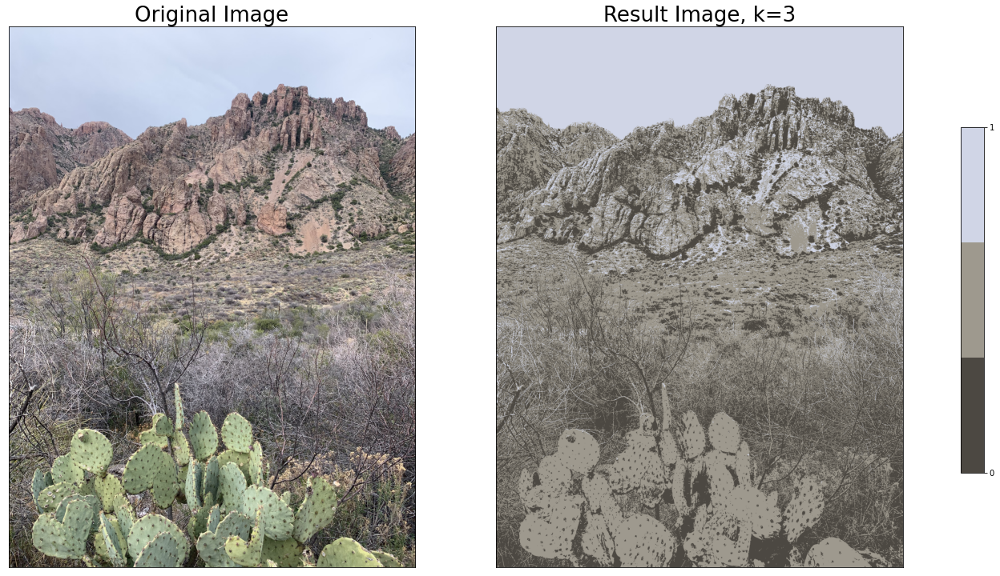

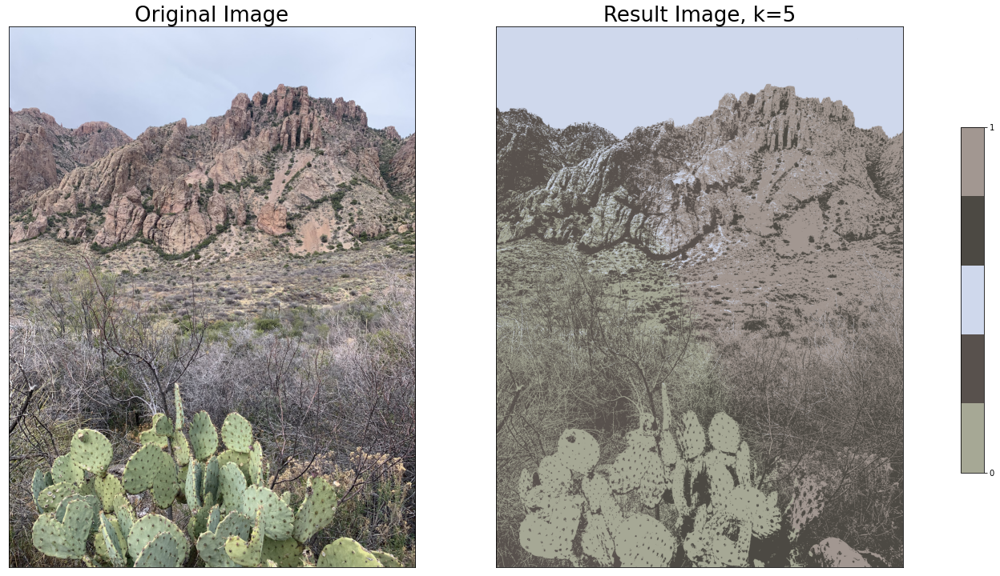

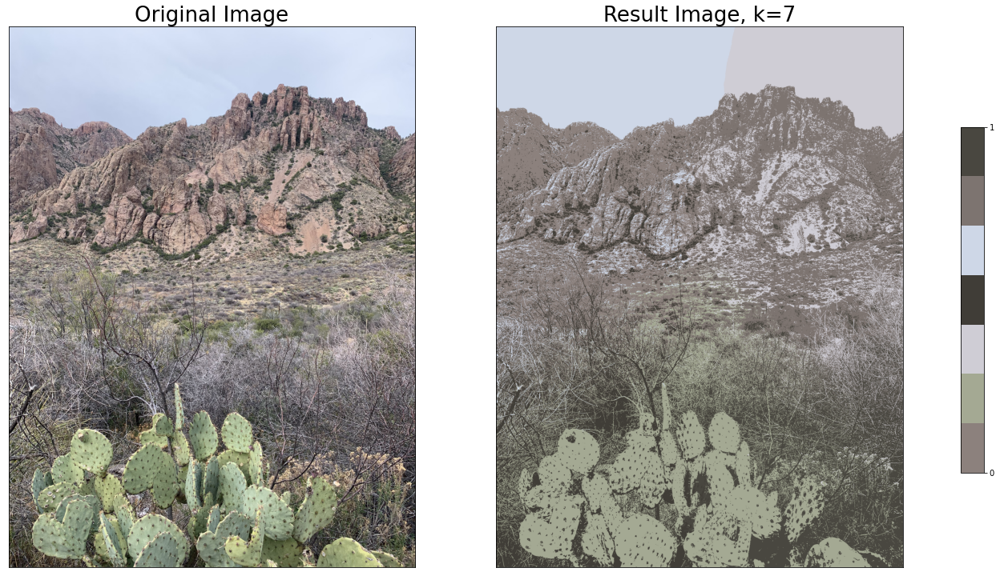

/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_9548.jpeg


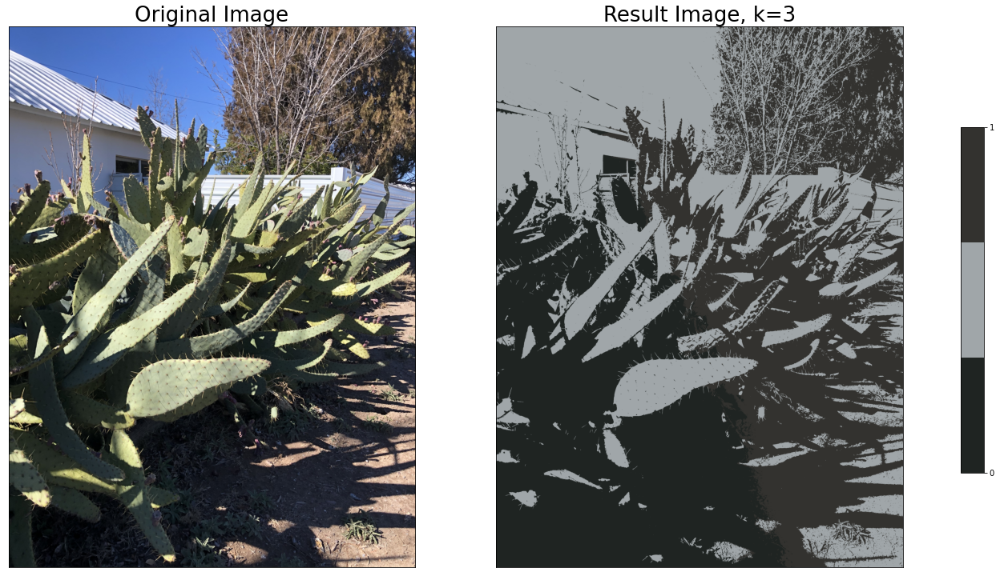

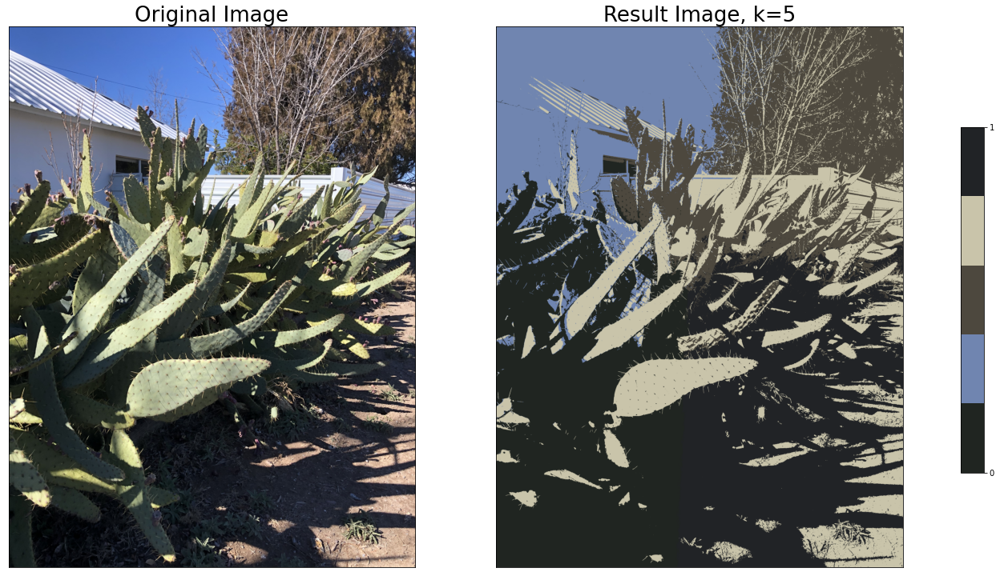

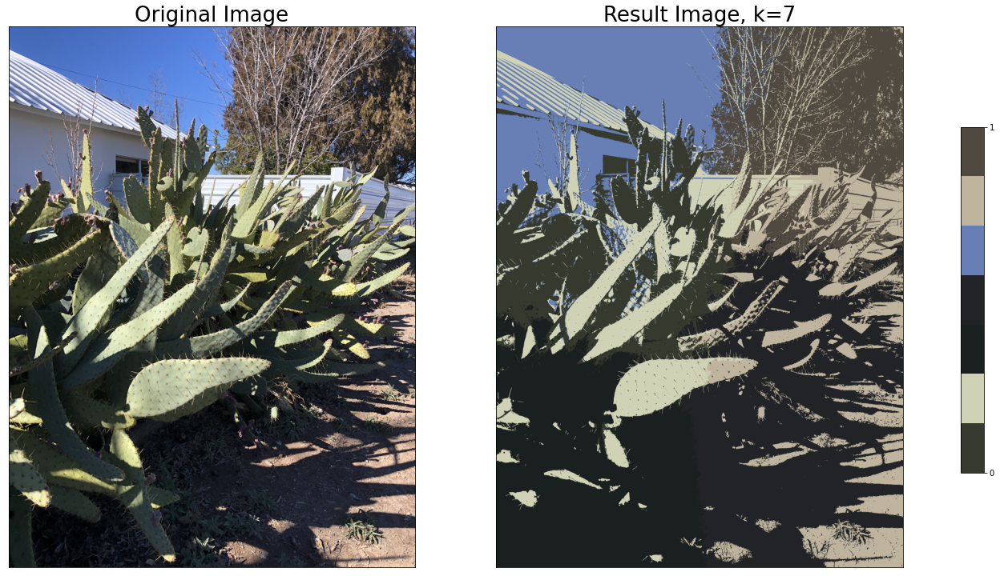

/Users/mcmahonmc/Github/machine-learning-2021/01_kmeans/IMG_2085.jpeg


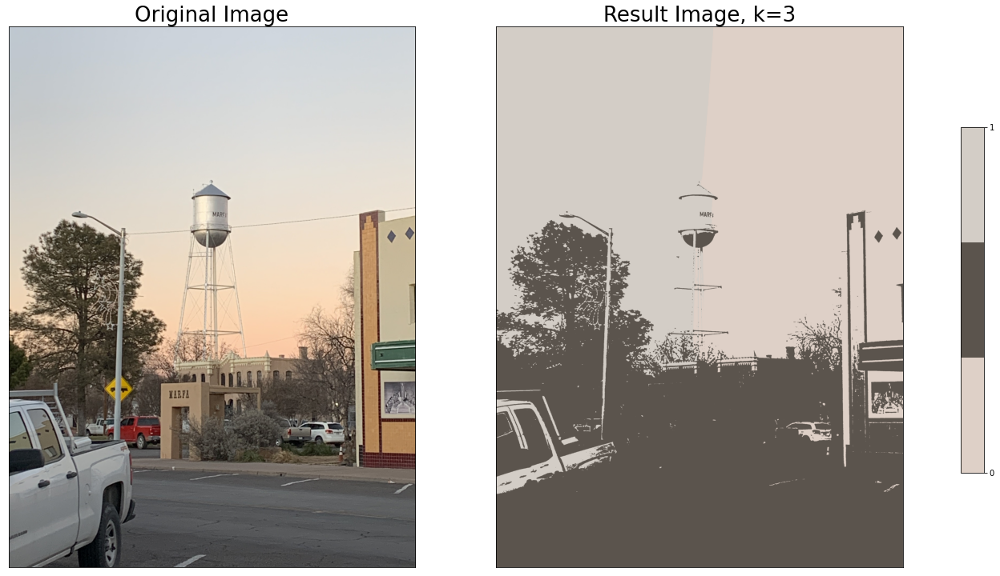

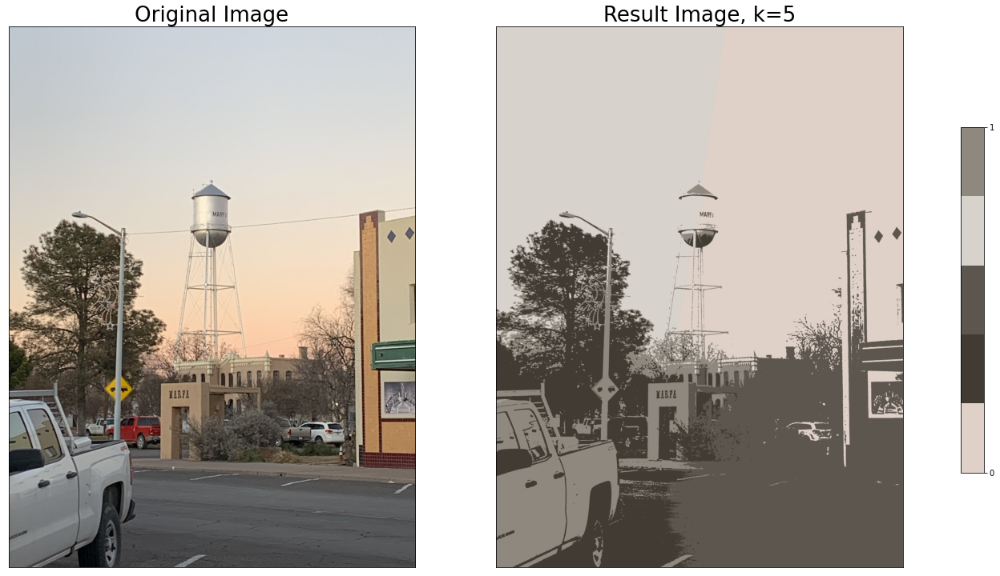

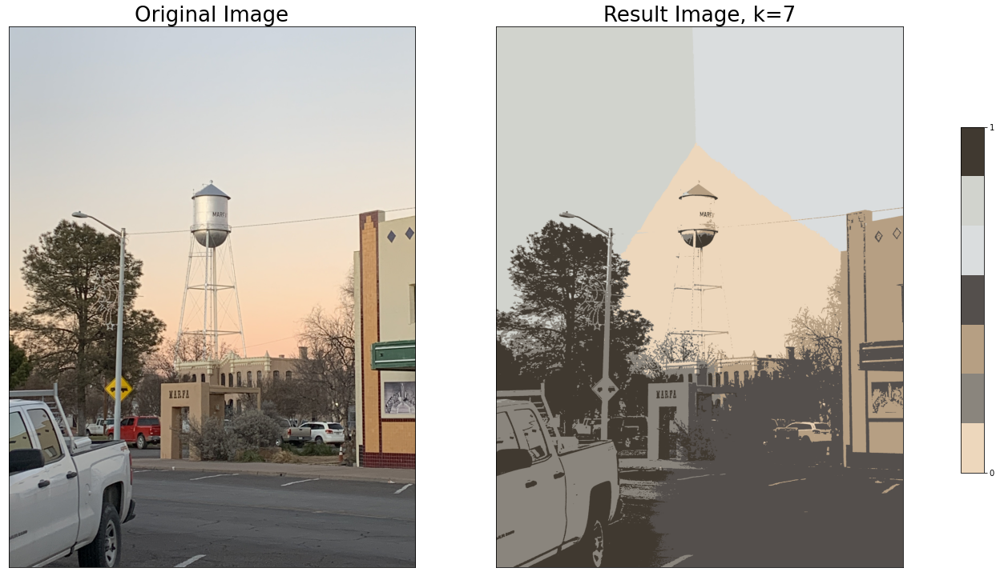

In [15]:
from sklearn.preprocessing import minmax_scale

for image in image_files:
    
    print(image)
    
    img0 = cv2.imread(image)
    img0 = cv2.cvtColor(img0, cv2.COLOR_BGR2RGB)
    
    # create xy
    x_ = np.zeros(len(img0[0,:,0]))
    x = []

    for i in range(0, len(img0[:,0,0])):
        x = np.append(x, x_)
        x_ = x_+1
    
    y_ = np.arange(0, len(img0[0,:,0]))
    y = np.tile(y_, len(img0[:,0,0]))
    
    xy = np.vstack((x, y)).transpose().astype(int)
    
    #convert the MxNx3 image to a Kx3 image where k = MxN
    vectorized = img0.reshape((-1,3))
    
    #add spatial coordinates
    vec_xy = np.concatenate((vectorized, xy), axis=1)
    
    xy_scaled = minmax_scale(xy, feature_range=(0,255))
    
    vec_xy = np.concatenate((vectorized, xy_scaled), axis=1).astype(np.float32)

    for k in K:

        ret,label,center=cv2.kmeans(vec_xy,k,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)

        center = np.uint8(center)

        res2 = center[label.flatten()]
        result_image2 = res2[:,0:3].reshape((img0.shape))
        cv2.imwrite(image.split('/IMG')[0] + '/results/' + image.split('kmeans/')[1].split('.jpeg')[0] + '_xy_k-%s.jpeg' % k, result_image2)

        fig, axs = plt.subplots(1,2, figsize=(20, 20))
        axs[0].imshow(img0)
        axs[0].set_title('Original Image', fontsize = 26)

        axs[1].imshow(result_image2)
        axs[1].set_title('Result Image, k=%s' % int(k), fontsize = 26)

        cmap = mpl.colors.ListedColormap(center[:,0:3]/255)
        bounds = np.linspace(0, len(center[:,0:3]), len(center[:,0:3]), dtype=int)
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

        cb_ax = fig.add_axes([0.95, 0.35, 0.02, 0.3])
        cbar = fig.colorbar(mpl.cm.ScalarMappable(cmap=cmap), cax=cb_ax, ticks=bounds, orientation='vertical', shrink=0.2)

        for ax in axs:
            ax.set_xticks([])
            ax.set_yticks([])
        
        plt.show()

    

In [16]:
res2

array([[209, 211, 205,  50,  56],
       [209, 211, 205,  50,  56],
       [209, 211, 205,  50,  56],
       ...,
       [ 84,  79,  76, 209, 180],
       [ 84,  79,  76, 209, 180],
       [ 84,  79,  76, 209, 180]], dtype=uint8)

In [17]:
res2.shape

(12192768, 5)

## Report

#### Write a brief report with segmentation results.  In your report, show both raw images and various output images with different k valuesand provide a summary of what you’ve learned bytrying the algorithm in different ways.